# Plotly Express 

# Marginal Plots Using Plotly
1. These plots are use when outliers remove because we want to see outliers in each graph so we use marginal graph

In [1]:
import pandas as pd #this lib use for data frame
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px # this lib use for plots
import plotly.graph_objects as go # graph customising 

In [2]:
import warnings
warnings.filterwarnings('ignore')

In [3]:
df=pd.read_csv('D:\Data Visualization\Data_Visualization\diamonds.csv')
print(df.shape)
df=df.sample(frac=0.1,random_state=10) # This is 10% of data
print(df.shape)

(53940, 11)
(5394, 11)


In [4]:
df.head()

,Unnamed: 0,carat,cut,color,clarity,depth,table,price,x,y,z
8018,8019,1.01,Premium,E,SI1,61.7,56.0,4330,6.44,6.39,3.96
1583,1584,0.70,Very Good,D,VS1,60.4,58.0,3008,5.71,5.78,3.47
9138,9139,1.13,Very Good,H,SI2,59.8,59.0,4537,6.75,6.82,4.06
2787,2788,0.76,Ideal,F,VS2,61.0,55.0,3257,5.89,5.92,3.60
52429,52430,0.70,Premium,I,VVS1,61.2,59.0,2513,5.65,5.69,3.47


In [5]:
df.reset_index(drop=True,inplace=True)

In [6]:
df

,Unnamed: 0,carat,cut,color,clarity,depth,table,price,x,y,z
0,8019,1.01,Premium,E,SI1,61.7,56.0,4330,6.44,6.39,3.96
1,1584,0.70,Very Good,D,VS1,60.4,58.0,3008,5.71,5.78,3.47
2,9139,1.13,Very Good,H,SI2,59.8,59.0,4537,6.75,6.82,4.06
3,2788,0.76,Ideal,F,VS2,61.0,55.0,3257,5.89,5.92,3.60
4,52430,0.70,Premium,I,VVS1,61.2,59.0,2513,5.65,5.69,3.47
...,...,...,...,...,...,...,...,...,...,...,...
5389,26954,2.07,Very Good,H,SI1,59.8,58.0,17019,8.23,8.26,4.93
5390,38256,0.26,Very Good,F,VS2,62.5,55.0,381,4.05,4.08,2.54
5391,39197,0.43,Premium,D,SI1,60.1,58.0,1064,4.93,4.89,2.95
5392,2656,1.05,Ideal,H,SI2,60.6,57.0,3234,6.59,6.55,3.98


In [7]:
# Scatter polot with marginal Histogram
fig = px.scatter(df, x="cut", y="price", 
                 marginal_x="histogram", 
                 marginal_y="histogram",title="Scatter plot with marginal Histogram")
fig.show()

In [8]:
# subplot with marginal histogram
fig = px.scatter(df, x="cut", y="price", 
                 marginal_x="violin", 
                 marginal_y="histogram",title="Scatter plot with marginal Histogram")
fig.show()

In [9]:
# Scatter plot with facet 
fig=px.scatter(df,x='carat',y='price',facet_col='cut'
               ,facet_row='clarity',
               marginal_x='histogram',
               marginal_y='violin',title='Histogram vs violin plot with facets ',
               color='clarity')
# Size 
fig.update_layout(height=1200,width=800)
fig.show()

# Video Animated Plots 

In [10]:
# Animated PLot
fig=px.scatter(df,x='carat',y='price',color='cut',size='price',animation_frame='cut',facet_col='clarity')
fig.show()

In [11]:
fig=px.scatter(df,x='clarity',y='price',color='cut',animation_frame='cut',facet_col='clarity'
)
fig.update_layout(height=1200,width=1200)
fig.show()

#save in html
fig.write_html('Clarity vs Price With animated frame.html ')


MoviePy - Building file output_videos\animated_plot.gif with imageio.


MoviePy - Building video output_videos\animated_plot.mp4.
MoviePy - Writing video output_videos\animated_plot.mp4



MoviePy - Done !
MoviePy - video ready output_videos\animated_plot.mp4
MoviePy - Building video output_videos\animated_plot_HD.mp4.
MoviePy - Writing video output_videos\animated_plot_HD.mp4



MoviePy - Done !
MoviePy - video ready output_videos\animated_plot_HD.mp4


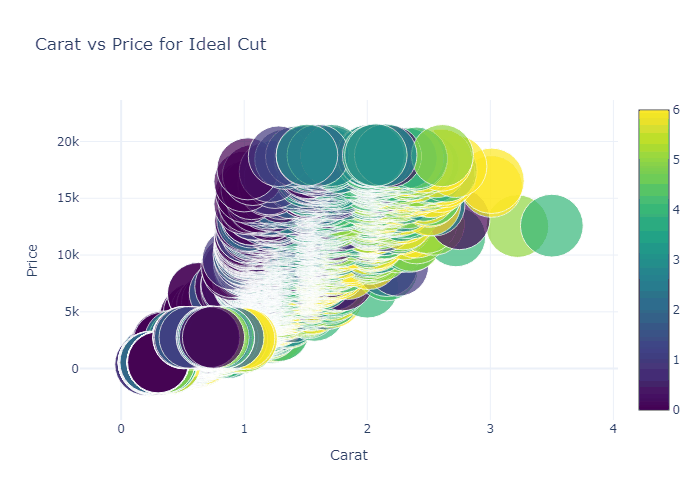

In [12]:
import plotly.graph_objects as go
import pandas as pd
import seaborn as sns
import os
from moviepy.video.io.ImageSequenceClip import ImageSequenceClip

# Load the diamonds dataset
df = sns.load_dataset('diamonds')

# Check for missing values
if df.isnull().any().any():
    raise ValueError("The dataset contains missing values. Please handle them before plotting.")

# Create a directory to save frames
frames_dir = "frames_alternative"
os.makedirs(frames_dir, exist_ok=True)

# Extract unique values for the 'cut' column
unique_cuts = df['cut'].unique()

# Save each frame as an image
for i, cut in enumerate(unique_cuts):
    # Filter the data for the current cut
    filtered_df = df[df['cut'] == cut]

    # Skip empty data
    if filtered_df.empty:
        continue

    # Create the scatter plot for the current cut
    fig = go.Figure(
        data=go.Scatter(
            x=filtered_df['carat'],
            y=filtered_df['price'],
            mode='markers',
            marker=dict(
                size=filtered_df['depth'],
                color=filtered_df['color'].astype('category').cat.codes,
                colorscale='Viridis',
                showscale=True
            ),
            text=filtered_df['clarity'],
            hoverinfo='text+x+y'
        )
    )

    # Update layout
    fig.update_layout(
        title=f'Carat vs Price for {cut} Cut',
        xaxis_title='Carat',
        yaxis_title='Price',
        template='plotly_white'
    )

    # Save the frame as an image
    frame_filename = os.path.join(frames_dir, f"frame_{i:03d}.png")
    fig.write_image(frame_filename, engine="kaleido")

# Create a GIF or MP4 using moviepy
image_files = [os.path.join(frames_dir, f) for f in sorted(os.listdir(frames_dir)) if f.endswith('.png')]
clip = ImageSequenceClip(image_files, fps=2)  # Adjust fps as needed

# Save outputs
output_dir = "output_videos"
os.makedirs(output_dir, exist_ok=True)

clip.write_gif(os.path.join(output_dir, "animated_plot.gif"), fps=2)
clip.write_videofile(os.path.join(output_dir, "animated_plot.mp4"), fps=1)
clip.write_videofile(os.path.join(output_dir, "animated_plot_HD.mp4"), fps=1, codec="libx264", preset="ultrafast", bitrate="3000k")

# Display the GIF in Jupyter Notebook
from IPython.display import Image
Image(os.path.join(output_dir, "animated_plot.gif"))


In [13]:
# Scatter plot 
fig=px.scatter(df,x='carat',y='price',color='cut',log_x=True,log_y=True) # through log x and log y values shrink and data would be normalize 
fig.show()

In [14]:
# Scatter plot ranges 
fig=px.scatter(df,x='carat',y='price',color='cut',range_x=[0.5,2],range_y=[1000,5000],title='Custom Axes ranges')
fig.show()

In [15]:
#polar chart
polar_chart = go.Figure(data=[go.Scatterpolar(
    r=[1, 2, 3, 4],
    theta=['a', 'b', 'c', 'd'],
    fill='toself'
)])
polar_chart.show()

In [16]:
# Heatmap 
fig=px.imshow(df[['price','carat','x','y','depth','table']].corr(),
              text_auto=True,
              title="Correlation Heatmap with Anotations")
fig.show()

In [17]:
# Sunburst plot
fig=px.sunburst(df,path=['cut','clarity'],values='price',color='cut')
fig.show()

In [18]:
from plotly.subplots import make_subplots
# Creating a subplots 
fig=make_subplots(rows=1,cols=2)
# Adding a subplot to the figure
fig.add_trace(go.Scatter(x=df['cut'],y=df['carat']),row=1,col=1)
fig.add_trace(go.Scatter(x=df['cut'],y=df['price']),row=1,col=2)
# title
fig.update_layout(title_text="Price vs Carat and Cut")
fig.show()

In [28]:
# Scatter Dual axies plots 
fig =make_subplots(specs=[[{"secondary_y": True}]])

fig.add_trace(go.Scatter(x=df['carat'],y=df['price']),secondary_y=False)
fig.add_trace(go.Scatter(x=df['carat'],y=df['depth']),secondary_y=True)

fig.update_layout(title_text="Price vs Carat with dual axis")
# labels 
fig.update_yaxes(title_text="price",secondary_y=False)
fig.update_yaxes(title_text="depth",secondary_y=True)
fig.show()

In [32]:
# Waterfall chart
cut_avg_price=df.groupby('cut')['price'].mean().reset_index()
# create waterfall chat by using plotly.graph_objects.Waterfall
fig = go.Figure(go.Waterfall( name = "Average Price",
                                    orientation = "v",
                                    x=cut_avg_price['cut'],
                                    y=cut_avg_price['price']
                                    ))
fig.update_layout(title_text="Average Price by Cut",title_x=0.5)
fig.show()

In [44]:
# Funnal chart for clarity distribution 
clarity_count=df['clarity'].value_counts().reset_index()
clarity_count.columns=['clarity','count']
# Funnal chart for clarity distribution
fig =px.funnel(clarity_count,
    y='clarity',
    x='count',title='Funnal Clarity Distribution'
)
fig.show()

In [53]:
# Bullet chart 
import plotly.graph_objects as go

# Assuming df['price'] exists and contains numerical data
fig = go.Figure(go.Indicator(
    mode="gauge+number",
    value=df['price'].mean(),
    title={
        'text': "Bullet Chart",
        'font': {
            'size': 20,
            'color': "red"
        }
    },
    gauge={
        'axis': {
            'range': [0, df['price'].max()]
        }
    }
))

fig.show()


In [57]:
# Candlestick chart for price of trends (using carat as a time-like variable)
fig=go.Figure(data=[go.Candlestick(x=df['carat'],
                                   open=df['price'],
                                   high=df['price'],
                                   low=df['price'],
                                   close=df['price'])])
fig.update_layout(title="Candlestick Chart for Price Trends")
fig.show()

In [59]:
# Ternary chart for price vs carat and table
fig=px.scatter_ternary(df,a='carat',b='price',c='table',title="Ternary Chart for Price vs Carat and Table")
fig.show()

In [61]:
# Area Chart 
df_cut_carat=df.groupby(['cut','carat'])['price'].mean().reset_index()
fig=px.area(df,x='carat',y='price',color='cut',title="Area Chart for Price vs Carat and Cut")
fig.show()